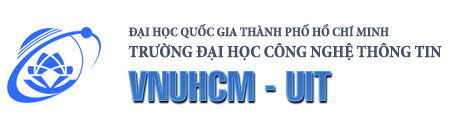

`Môn học: Nhập môn Thị giác máy tính - CS231.O22`

`Chủ đề: Single Object Tracking`

`GV hướng dẫn: TS. Mai Tiến Dũng`

`Thành viên nhóm:`

`Nguyễn Trung Kiên - 21521024`

`Võ Đức Dương - 21521992`

# `1. Giới thiệu bài toán`

`Single Object Tracking (SOT) là một bài toán quan trọng trong lĩnh vực xử lý ảnh và video, tập trung vào việc theo dõi vị trí và trạng thái của một đối tượng cụ thể trong một chuỗi khung hình video.`

`Input và output của bài toán SOT.`

`Input:`
* `Chuỗi frames của 1 video chứa đối tượng cần theo dõi.`
* `Vị trí của bounding box ở frame đầu tiên chứa đối tượng cần theo dõi trong video.`

`Output: Bounding box chứa đối tượng cần theo dõi trên tất cả các frames`

`Dataset sử dụng: LaSOT - là tập dữ liệu lớn chứa 1.400 video với hơn 3,5 triệu khung hình, được thiết kế để đánh giá hiệu suất thuật toán cho bài toán SOT. LaSOT giúp đánh giá khả năng thích ứng của thuật toán trong nhiều trường hợp thực tế.`

# `2. Định nghĩa một số tác vụ cơ bản`

## `2.1. Khai báo các thư viện sử dụng`

In [ ]:
from IPython.display import HTML
import os
import requests
import shutil
import random
import json
import pandas as pd
import numpy as np
import cv2
import zipfile
from tqdm import tqdm
from google.colab.patches import cv2_imshow
import imageio
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from skimage.transform import resize
import torch
import gc
from matplotlib.widgets import RectangleSelector
from moviepy.editor import VideoFileClip
import moviepy
%matplotlib inline

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Đường dẫn đến thư mục bộ dữ liệu trong Drive
data_path = "/content/drive/MyDrive/LaSOT"

## `2.2. Đọc frames từ 1 folder`

In [ ]:
# Hàm đọc các frames từ 1 folder
def read_frames_from_folder(folder_path):
    # List để chứa các frames
    filenames = [filename for filename in os.listdir(folder_path)]
    filenames = sorted(filenames, key=lambda x: int(x.split('.')[0]))
    frames = []
    for filename in filenames:
        if filename.endswith(('.jpg', '.jpeg', '.png', '.bmp')):  # Adjust file extensions as needed
            # Construct the full path to the image file
            image_path = os.path.join(folder_path, filename)

            # Read the image
            frame = cv2.imread(image_path, cv2.COLOR_BGR2RGB)

            # Append the frame to the list
            frames.append(frame)
    return frames

In [ ]:
folder_path = '/content/drive/MyDrive/LaSOT/mouse-1/img'
frames = read_frames_from_folder(folder_path)

Frame 1


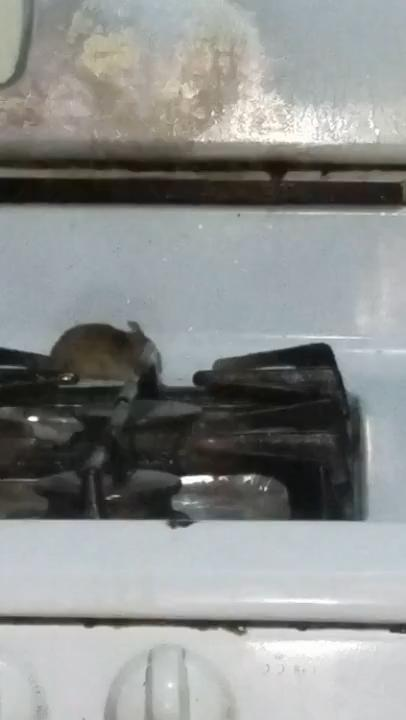

Frame 2


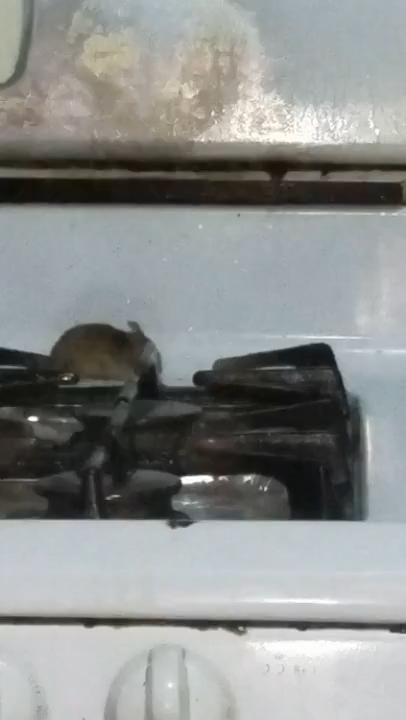

Frame 3


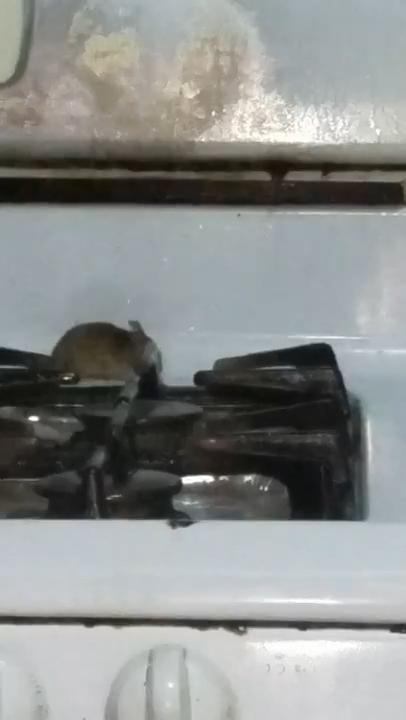

Frame 4


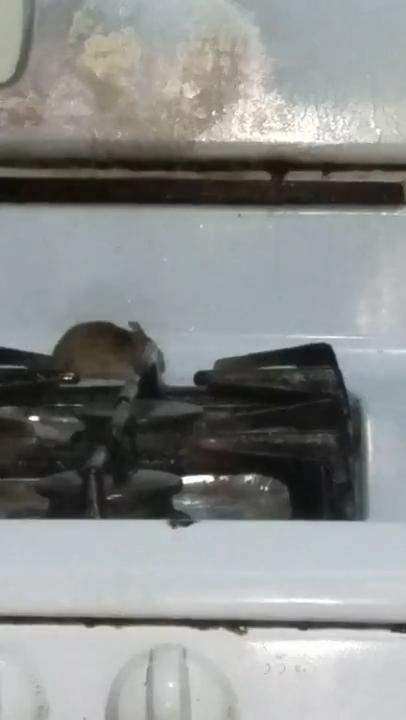

Frame 5


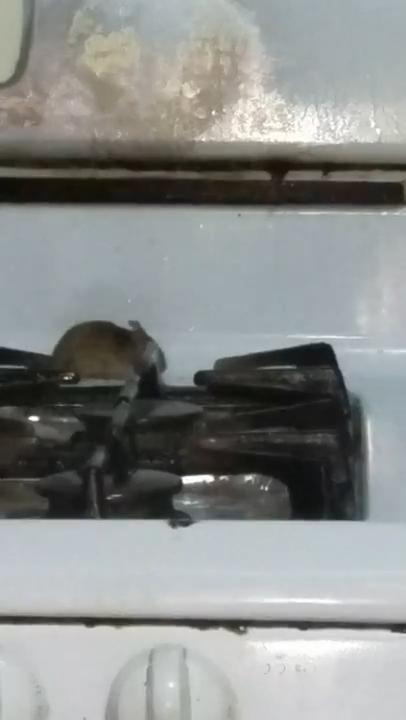

In [ ]:
# # test chức năng: 5 frames đầu tiên
for i, frame in enumerate(frames):
    if (i == 5):
        break
    print("Frame", i + 1)
    cv2_imshow(frame)

## `2.3. Tạo video từ frames`

In [ ]:
def create_video_from_frames(frames, output_path, fps=30):
    """
    Create a video file from a sequence of frames.
    Parameters:
        frames (list): List of frames (each frame is a NumPy array).
        output_path (str): Name of the output video file.
        fps (int): Frames per second of the output video. Default is 30.
    """
    if not frames:
        raise ValueError("No frames provided.")

    writer = imageio.get_writer(output_path, fps=fps)
    # Write each frame to the video
    for frame in frames:
        writer.append_data(frame)
    # Close the writer to finalize the video
    writer.close()

In [ ]:
# test chức năng
output_video_path = 'output_video2.mp4'
fps = 24
create_video_from_frames(frames[:24], output_video_path, fps)

In [ ]:
root_dir = '/content/drive/MyDrive/LaSOT'
folders = [folder for folder in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, folder))]
for folder in folders:
    print('Processing: ', folder)
    files = [file for file in os.listdir(os.path.join(root_dir, folder))]
    if 'output_video.mp4' in files:
        continue
    frames = []
    frames = read_frames_from_folder(os.path.join(root_dir, folder) + '/img')
    output_video_path = os.path.join(root_dir, os.path.join(folder, "output_video.mp4"))
    create_video_from_frames(frames, output_video_path, fps = 30)
    print('---------------Done-----------------')
    frames = []

Processing:  mouse-7
Processing:  mouse-3
Processing:  mouse-6
Processing:  mouse-19
Processing:  mouse-5
Processing:  mouse-2
Processing:  mouse-9
Processing:  mouse-8
Processing:  mouse-20
Processing:  mouse-4
Processing:  mouse-16
Processing:  mouse-15
Processing:  mouse-11
Processing:  mouse-13
Processing:  mouse-1
Processing:  mouse-12
Processing:  mouse-10
Processing:  mouse-17
Processing:  mouse-18
Processing:  mouse-14
Processing:  person-3
Processing:  person-4
Processing:  person-5
Processing:  person-6
---------------Done-----------------
Processing:  person-7
---------------Done-----------------
Processing:  person-9
---------------Done-----------------
Processing:  person-10
---------------Done-----------------
Processing:  person-11
---------------Done-----------------
Processing:  person-12
---------------Done-----------------


## `2.4. Trình chiếu video`

In [ ]:
def display_video(video):
    fig = plt.figure(figsize=(6,6))
    mov = []
    for i in range(len(video)):
      img = plt.imshow(video[i],animated=True)
      plt.axis('off')
      mov.append([img])
    anm = animation.ArtistAnimation(fig,mov,interval=50,repeat_delay=1000)
    plt.close()
    return anm

In [ ]:
video = imageio.mimread('output_video2.mp4')
HTML(display_video(video).to_html5_video())

## `2.5. Vẽ bounding box`

In [ ]:
def draw_bounding_box(frame, bounding_box, color, thickness=2):
    x_min, y_min, width, height = bounding_box
    x_max, y_max = x_min + width, y_min + height
    cv2.rectangle(frame, (x_min, y_min), (x_max, y_max), color, thickness)

In [ ]:
# Tạo video có bounding box là grouth-truth
gt_bboxes = []
with open('/content/drive/MyDrive/LaSOT/mouse-1/groundtruth.txt', 'r') as file:
    for line in file:
        bbox = list(map(int, line.strip().split(',')))
        gt_bboxes.append(bbox)

grouth_truth_frames = read_frames_from_folder(folder_path)
for i in range(len(grouth_truth_frames)):
    draw_bounding_box(grouth_truth_frames[i], gt_bboxes[i], (0, 0, 255), 2)

create_video_from_frames(grouth_truth_frames, '/content/drive/MyDrive/mouse/mouse-1/tracking_output_video_grouth_truth.mp4', 24)

# `3. Metrics: IOU và successful rate`

## `3.1. IoU`

In [ ]:
# Hàm tính IOU
def calculate_iou(bbox1, bbox2):
    x1, y1, w1, h1 = bbox1
    x2, y2, w2, h2 = bbox2

    # Check if any of the bounding boxes has zero area
    if w1 == 0 or h1 == 0 or w2 == 0 or h2 == 0:
        return 0.0  # If any bounding box has zero area, IoU is 0

    # Calculate intersection coordinates
    x_left = max(x1, x2)
    y_top = max(y1, y2)
    x_right = min(x1 + w1, x2 + w2)
    y_bottom = min(y1 + h1, y2 + h2)

    if x_right < x_left or y_bottom < y_top:
        return 0.0  # Bounding boxes do not overlap

    intersection_area = (x_right - x_left) * (y_bottom - y_top)
    area1 = w1 * h1
    area2 = w2 * h2
    union_area = area1 + area2 - intersection_area

    iou = intersection_area / union_area
    return iou


## `3.2. Successful rate`

In [ ]:
def evaluate_tracking(bboxes, gt_bboxes):
    success_count = 0

    if(len(bboxes) != len(gt_bboxes)):
        print("2 tập bounding box có kích thước khác nhau")
    else:
        for i in range(len(bboxes)):
            # Read the current frame
            bbox = bboxes[i]
            gt_bbox = gt_bboxes[i]
            iou = calculate_iou(bbox, gt_bbox)
            if iou > 0.5:
                success_count += 1
        # Calculate success rate
        success_rate = (success_count / len(bboxes)) * 100

    return (success_count, len(bboxes), success_rate)

# `4. Các giải pháp cho bài toán SOT`

In [ ]:
# Màu của bounding box cho từng phương pháp
green = (0, 255, 0) # Grouth-truth
blue = (0, 0, 255) # histogram-based method
red = (255, 0, 0) # yolov9 method

## `4.1. Histogram + Mean Shift Tracker`

In [ ]:
hist_tracking_frames = read_frames_from_folder('/content/drive/MyDrive/LaSOT/mouse-1/img')

In [ ]:
def calculate_histogram(frame, region):
    x, y, w, h = region
    roi = frame[y:y+h, x:x+w]

    # Calculate histogram for each channel separately
    hist_red = cv2.calcHist([roi], [0], None, [256], [0, 256])
    hist_green = cv2.calcHist([roi], [1], None, [256], [0, 256])
    hist_blue = cv2.calcHist([roi], [2], None, [256], [0, 256])

    # Normalize histograms
    cv2.normalize(hist_red, hist_red, 0, 255, cv2.NORM_MINMAX)
    cv2.normalize(hist_green, hist_green, 0, 255, cv2.NORM_MINMAX)
    cv2.normalize(hist_blue, hist_blue, 0, 255, cv2.NORM_MINMAX)

    # Concatenate histograms into a single feature vector
    color_histogram = np.concatenate((hist_red, hist_green, hist_blue))

    return color_histogram

def HistogramTracker(frames, initial_region):
    target_hist = calculate_histogram(frames[0], initial_region)
    term_criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 1)

    tracked_regions = []
    tracked_regions.append(initial_region)
    current_region = initial_region

    for i in range(1, len(frames)):
        x, y, w, h = current_region
        hsv_frame = cv2.cvtColor(frames[i], cv2.COLOR_BGR2HSV)
        dst = cv2.calcBackProject([hsv_frame], [0], target_hist, [0, 256], 1)
        ret, new_region = cv2.meanShift(dst, (x, y, w, h), term_criteria)
        new_x, new_y, new_w, new_h = new_region
        new_region = (int(new_x), int(new_y), int(new_w), int(new_h))
        tracked_regions.append(new_region)
        current_region = new_region

    return tracked_regions

In [ ]:
# Tạo video demo SOT
initial_region = (52, 316, 113, 65)
htb_boxes = HistogramTracker(hist_tracking_frames, initial_region)
for i in range(len(htb_boxes)):
    frame = hist_tracking_frames[i]
    new_region = htb_boxes[i]
    draw_bounding_box(frame, new_region, color = red)

cv2.destroyAllWindows()

In [ ]:
create_video_from_frames(hist_tracking_frames, '/content/drive/MyDrive/LaSOT/mouse-1/tracking_output_video_using_histogram_meanshift_tracker.mp4', 30)

## `4.2. YOLOv9 + deep-sort-realtime 1.3.2`

In [ ]:
# Install libraries
!git clone https://github.com/duong28022003/Yolov9_tracking.git
!pip install utils
!pip install imutils
!pip install Pillow
!pip install deep-sort-realtime

# import libraries
from deep_sort_realtime.deepsort_tracker import DeepSort
%cd Yolov9_tracking/
from models.common import DetectMultiBackend, AutoShape

Cloning into 'Yolov9_tracking'...
remote: Enumerating objects: 446, done.
remote: Counting objects: 100% (296/296), done.
remote: Compressing objects: 100% (94/94), done.
remote: Total 446 (delta 226), reused 202 (delta 202), pack-reused 150
Receiving objects: 100% (446/446), 2.58 MiB | 25.63 MiB/s, done.
Resolving deltas: 100% (232/232), done.
  Preparing metadata (setup.py) ... done
  Created wheel for utils: filename=utils-1.0.2-py2.py3-none-any.whl size=13906 sha256=86625604d6a31dc80b144f1721e1ee6755b1aa2c4f72a48e8e7e3dd1fe91bc9b
  Stored in directory: /root/.cache/pip/wheels/b8/39/f5/9d0ca31dba85773ececf0a7f5469f18810e1c8a8ed9da28ca7
Successfully built utils
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 54.6 MB/s eta 0:00:00
/content/Yolov9_tracking


In [ ]:
# DeepSort & Yolov9
device = torch.device('cuda:0') if torch.cuda.is_available() else torch.device('cpu')
model = DetectMultiBackend(weights='/content/drive/MyDrive/LaSOT/weight/yolov9-e.pt', device = device, fuse = True)
model = AutoShape(model)
# class names
with open('./data_ext/classes.names') as f:
    class_name = f.read().strip().split('\n')
# target tracking class
tracking_class = class_name.index('mouse')

Fusing layers... 
gelan-e summary: 690 layers, 57345920 parameters, 50926448 gradients
Adding AutoShape... 


In [ ]:
def YOLO_deepSORT_tracking(first_xywh,
                           tracking_class = tracking_class,
                           max_age = 10,
                           video_path = None,
                           frames = None,
                           frames_path = None,
                           ):
    ''' Parameters:
    tracking_class: classID of target, which is pre-defined by YOLO
    first_xywh: bounding box for the first frame
    max_age: maximum number of missed misses before a track is deleted.
    video_path: input video path
    frames: list of input frames
    frames_path: input frames path
    ---------------------------------------------------------------
    At least on of follow parameters must be passed: video_path, frames, frames_path. This parameters will define the input frames.
    '''
    # get frames
    if (not video_path) and (not frames) and (not frames_path):
        raise ValueError('Cound not find the input frame. Passing at least one of three parameters:  video_path, frames, frames_path')

    if not frames:
        print("Start reading frames")
        print("-"*50)
        if frames_path:
            frames = read_frames_from_folder(frames_path)
        elif video_path:
            frames = []
            cap = cv2.VideoCapture(video_path)
            while True:
                ret, frame = cap.read()
                if not ret:
                    break
                frames.append(frame)
            cap.release()
        print(f'Read frames finished! Total frames: {len(frames)}')


    tracker = DeepSort(max_age=max_age)
    # define the initial detection corresponding to the first frame

    first_frame = frames[0]
    first_detection = [[first_xywh, 1, tracking_class]]
    tracks = tracker.update_tracks(first_detection, frame = first_frame)      # update the tracker with the first frame
    object_id = 0             # get object_id
    for track in tracks:
          ltrb = track.to_ltrb()
          x1, y1, x2, y2 = map(int, ltrb)
          w = x2 - x1
          h = y2 - y1
          region = [x1,y1,w,h]
          iou = calculate_iou(region, first_xywh)
          if iou == 1:
              object_id = track.track_id

    track_regions = [first_xywh]       # list of boundingbox's position
    R = (255,0,0)

    # tracking on the rest frames

    print('Start tracking')
    print('-'*50)
    for i in range(1,len(frames)):
        frame = frames[i]
        if (i-1)%200 == 0:
              print(f'frame: {i}')
        # object detection
        results = model(frame)
        detect = []
        detect_with_correct_id = []
        for detect_object in results.pred[0]:
            label, conf, bbox = detect_object[5],  detect_object[4],  detect_object[:4]
            x1, y1, x2, y2 = map(int, bbox)
            class_id = int(label)
            bbox_xywh = [x1, y1, x2-x1, y2-y1]
            if class_id == tracking_class:
                detect_with_correct_id.append([bbox_xywh, conf, class_id])
            detect.append([bbox_xywh,conf, class_id])

        # object tracking
        if len(detect_with_correct_id) == 0:
            tracks = tracker.update_tracks(detect, frame = frame)
        else:
            tracks = tracker.update_tracks(detect_with_correct_id, frame = frame)
        region = []
        max_conf = 0
        for track in tracks:
            if track.track_id != object_id:
                conf = track.get_det_conf()
                if conf and conf > max_conf:
                      max_conf = conf
                      ltrb = track.to_ltrb()
                      x1, y1, x2, y2 = map(int, ltrb)
                      w = x2 - x1
                      h = y2 - y1
                      region = [x1,y1,w,h]
            else:
                ltrb = track.to_ltrb()
                x1, y1, x2, y2 = map(int, ltrb)
                w = x2 - x1
                h = y2 - y1
                region = [x1,y1,w,h]
                break

        # tracking success
        if len(region) > 0:
            track_regions.append(region)

        # tracking failed
        if len(track_regions) != i+1:
              track_regions.append(track_regions[-1])   # choose the last track regions

    frames.clear()
    gc.collect()

    print('Tracking finished')

    return track_regions

# `5. Đánh giá phương pháp`

## `5.1. Histogram + Mean Shift Tracker`

In [ ]:
root_dir = '/content/drive/MyDrive/LaSOT'
folders = [folder for folder in os.listdir(root_dir) if os.path.isdir(os.path.join(root_dir, folder))]

sum_succ = 0
sum_frames = 0

for folder in folders:
    print("Processing folder:", folder)
    folder_path_ = os.path.join(root_dir, folder)
    frames = []
    frames = read_frames_from_folder(folder_path_ + '/img')
    gt_bboxes = []
    with open(folder_path_ + '/groundtruth.txt', 'r') as file:
        for line in file:
            bbox = list(map(int, line.strip().split(',')))
            gt_bboxes.append(bbox)
    htb_boxes = HistogramTracker(frames, gt_bboxes[0])
    a, b, c = evaluate_tracking(htb_boxes, gt_bboxes)
    print('-- The number of successful frames: ' + str(a))
    print('-- Total frames: ' + str(b))
    print('-- Successful rate: ' + str(c))
    sum_succ += a
    sum_frames += b
print('Successful rate of feature-based method using histogram + Mean Shift Tracker: ' + str(sum_succ / sum_frames))

Processing folder: mouse-7
-- The number of successful frames: 3
-- Total frames: 1794
-- Successful rate: 0.16722408026755853
Processing folder: mouse-3
-- The number of successful frames: 1
-- Total frames: 1990
-- Successful rate: 0.05025125628140704
Processing folder: mouse-6
-- The number of successful frames: 9
-- Total frames: 1238
-- Successful rate: 0.7269789983844911
Processing folder: mouse-19
-- The number of successful frames: 34
-- Total frames: 2805
-- Successful rate: 1.2121212121212122
Processing folder: mouse-5
-- The number of successful frames: 1
-- Total frames: 2390
-- Successful rate: 0.04184100418410042
Processing folder: mouse-2
-- The number of successful frames: 16
-- Total frames: 2143
-- Successful rate: 0.7466168922071862
Processing folder: mouse-9
-- The number of successful frames: 7
-- Total frames: 2818
-- Successful rate: 0.248403122782115
Processing folder: mouse-8
-- The number of successful frames: 2
-- Total frames: 1275
-- Successful rate: 0.1568

## `5.2. YOLO + deepSORT`

In [ ]:
root_dir = '/content/drive/MyDrive/LaSOT/'
mouse_folder= [root_dir + 'mouse-' + str(i) for i in range(1,21)]
person_folder = [root_dir + 'person-' + str(i) for i in range(3,13)]

In [ ]:
def execute_YOLO(folder_path, tracking_class):
    gt_bboxes = []
    with open(folder_path + '/groundtruth.txt', 'r') as file:
        for line in file:
            bbox = list(map(int, line.strip().split(',')))
            gt_bboxes.append(bbox)
    tracking_regions = YOLO_deepSORT_tracking(first_xywh = gt_bboxes[0],
                                              frames_path = folder_path + '/img',
                                              tracking_class = tracking_class)
    ssc, total_frames, _ = evaluate_tracking(tracking_regions, gt_bboxes)
    np.savez_compressed(folder_path+'/YOLO_results.npz',
                        total_success = ssc,
                        total_frames = total_frames,
                        tracking_regions = tracking_regions)
    gt_bboxes.clear()
    tracking_regions.clear()
    gc.collect()

In [ ]:
def create_video_YOLO(frames, tracking_regions, output_path):
    for i in range(len(frames)):
        frame = frames[i]
        bbox = tracking_regions[i]
        draw_bounding_box(frame, bbox, color = blue)
    cv2.destroyAllWindows()
    create_video_from_frames(frames,output_path,30)

### `5.2.1. Mouse`

In [ ]:
# mouse-1
execute_YOLO(mouse_folder[0], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1547
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
Tracking finished


In [ ]:
# mouse-2
execute_YOLO(mouse_folder[1], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2143
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
Tracking finished


In [ ]:
# mouse-3
execute_YOLO(mouse_folder[2], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1990
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
Tracking finished


In [ ]:
# mouse-4
execute_YOLO(mouse_folder[3], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1941
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
Tracking finished


In [ ]:
# mouse-5
execute_YOLO(mouse_folder[4], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2390
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
Tracking finished


In [ ]:
# mouse-6
execute_YOLO(mouse_folder[5], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1238
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
Tracking finished


In [ ]:
# mouse-7
execute_YOLO(mouse_folder[6], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1794
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
Tracking finished


In [ ]:
# mouse-8
execute_YOLO(mouse_folder[7], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1275
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
Tracking finished


In [ ]:
# mouse-9
execute_YOLO(mouse_folder[8], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2818
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
Tracking finished


In [ ]:
# mouse-10
execute_YOLO(mouse_folder[9], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1864
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
Tracking finished


In [ ]:
# mouse-11
execute_YOLO(mouse_folder[10], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1756
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
Tracking finished


In [ ]:
# mouse-12
execute_YOLO(mouse_folder[11], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2243
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
Tracking finished


In [ ]:
# mouse-13
execute_YOLO(mouse_folder[12], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1156
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
Tracking finished


In [ ]:
# mouse-14
execute_YOLO(mouse_folder[13], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2120
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
Tracking finished


In [ ]:
# mouse-15
execute_YOLO(mouse_folder[14], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1406
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
Tracking finished


In [ ]:
# mouse-16
# frames = read_frames_from_folder('/content/drive/MyDrive/LaSOT/mouse-16/img')
execute_YOLO(mouse_folder[15], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 4642
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
frame: 3001
frame: 3201
frame: 3401
frame: 3601
frame: 3801
frame: 4001
frame: 4201
frame: 4401
frame: 4601
Tracking finished


In [ ]:
# mouse-17
execute_YOLO(mouse_folder[16], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1608
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
Tracking finished


In [ ]:
# mouse-18
execute_YOLO(mouse_folder[17], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2408
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
Tracking finished


In [ ]:
# mouse-19
execute_YOLO(mouse_folder[18], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2805
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
Tracking finished


In [ ]:
# mouse-20
execute_YOLO(mouse_folder[19], class_name.index('mouse'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1986
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
Tracking finished


#### `Results`

In [ ]:
num = [i for i in range(1,21)]
root_dir = '/content/drive/MyDrive/LaSOT/'
mouse_folder= [root_dir + 'mouse-' + str(i) +'/YOLO_results.npz' for i in num]
sum_scc = 0
sum_frames = 0
for path in mouse_folder:
    rs = np.load(path)
    scc, frames = rs['total_success'], rs['total_frames']
    print(f'Folder mouse-{num[mouse_folder.index(path)]}')
    print(f'Successful rate: {scc/frames*100}')
    sum_scc += scc
    sum_frames += frames

print(f'Average successful rate: {sum_scc / sum_frames * 100}')

Folder mouse-1
Successful rate: 2.9734970911441496
Folder mouse-2
Successful rate: 0.09332711152589827
Folder mouse-3
Successful rate: 0.05025125628140704
Folder mouse-4
Successful rate: 0.2575991756826378
Folder mouse-5
Successful rate: 0.04184100418410042
Folder mouse-6
Successful rate: 23.66720516962843
Folder mouse-7
Successful rate: 37.79264214046823
Folder mouse-8
Successful rate: 24.627450980392158
Folder mouse-9
Successful rate: 43.11568488289567
Folder mouse-10
Successful rate: 0.3218884120171674
Folder mouse-11
Successful rate: 0.05694760820045558
Folder mouse-12
Successful rate: 0.4458314757021846
Folder mouse-13
Successful rate: 1.8166089965397925
Folder mouse-14
Successful rate: 0.04716981132075472
Folder mouse-15
Successful rate: 0.42674253200568996
Folder mouse-16
Successful rate: 1.4002585092632487
Folder mouse-17
Successful rate: 4.539800995024875
Folder mouse-18
Successful rate: 33.18106312292359
Folder mouse-19
Successful rate: 51.05169340463458
Folder mouse-20
Succe

In [ ]:
num = [i for i in range(1,21)]
root_dir = '/content/drive/MyDrive/LaSOT/'
mouse_folder= [root_dir + 'mouse-' + str(i) for i in num]
img_path = [path + '/img' for path in mouse_folder]
video_path = [path +'/YOLO_output_video.mp4' for path in mouse_folder]
result_path = [path + '/YOLO_results.npz' for path in mouse_folder]
for i in range(len(mouse_folder)):
    frames = read_frames_from_folder(img_path[i])
    rs = np.load(result_path[i])['tracking_regions']
    print('Creating video mouse-' + str(i+1))
    create_video_YOLO(frames, rs, video_path[i])
    print('Creating video finished!')
    print('-'*50)
    frames = []
    rs = []
    gc.collect()

Creating video mouse-1


Creating video finished!
--------------------------------------------------
Creating video mouse-2
Creating video finished!
--------------------------------------------------


Creating video mouse-3
Creating video finished!
--------------------------------------------------


Creating video mouse-4
Creating video finished!
--------------------------------------------------


Creating video mouse-5
Creating video finished!
--------------------------------------------------


Creating video mouse-6
Creating video finished!
--------------------------------------------------


Creating video mouse-7
Creating video finished!
--------------------------------------------------


Creating video mouse-8
Creating video finished!
--------------------------------------------------


Creating video mouse-9
Creating video finished!
--------------------------------------------------
Creating video mouse-10
Creating video finished!
--------------------------------------------------


Creating video mouse-11
Creating video finished!
--------------------------------------------------
Creating video mouse-12
Creating video finished!
--------------------------------------------------


Creating video mouse-13
Creating video finished!
--------------------------------------------------


Creating video mouse-14
Creating video finished!
--------------------------------------------------


Creating video mouse-15
Creating video finished!
--------------------------------------------------
Creating video mouse-16
Creating video finished!
--------------------------------------------------


Creating video mouse-17
Creating video finished!
--------------------------------------------------
Creating video mouse-18
Creating video finished!
--------------------------------------------------
Creating video mouse-19
Creating video finished!
--------------------------------------------------
Creating video mouse-20
Creating video finished!
--------------------------------------------------


### `5.2.2. Person`

In [ ]:
# person-3
execute_YOLO(person_folder[0], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 3501
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
frame: 3001
frame: 3201
frame: 3401
Tracking finished


In [ ]:
# person-4
execute_YOLO(person_folder[1], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2465
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
Tracking finished


In [ ]:
# person-5
execute_YOLO(person_folder[2], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2967
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
Tracking finished


In [ ]:
# person-6
execute_YOLO(person_folder[3], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1054
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
Tracking finished


In [ ]:
# person-7
execute_YOLO(person_folder[4], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 2819
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
Tracking finished


In [ ]:
# person-9
execute_YOLO(person_folder[6], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1172
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
Tracking finished


In [ ]:
# person-10
execute_YOLO(person_folder[7], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 3901
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
frame: 2001
frame: 2201
frame: 2401
frame: 2601
frame: 2801
frame: 3001
frame: 3201
frame: 3401
frame: 3601
frame: 3801
Tracking finished


In [ ]:
# person-11
execute_YOLO(person_folder[8], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1756
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
Tracking finished


In [ ]:
# person-12
execute_YOLO(person_folder[9], class_name.index('person'))

Start reading frames
--------------------------------------------------
Read frames finished! Total frames: 1990
Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
frame: 1801
Tracking finished


#### Results

In [ ]:
num = [3,4,5,6,7,9,10,11,12]
root_dir = '/content/drive/MyDrive/LaSOT/'
folder= [root_dir + 'person-' + str(i) +'/YOLO_results.npz' for i in num]
sum_scc = 0
sum_frames = 0
for path in folder:
    rs = np.load(path)
    scc, frames = rs['total_success'], rs['total_frames']
    print(f'Folder person-{num[folder.index(path)]}')
    print(f'Successful rate: {scc/frames*100}')
    sum_scc += scc
    sum_frames += frames

print(f'Average successful rate: {sum_scc / sum_frames * 100}')

Folder person-3
Successful rate: 19.9371608111968
Folder person-4
Successful rate: 44.21906693711968
Folder person-5
Successful rate: 34.883720930232556
Folder person-6
Successful rate: 60.81593927893738
Folder person-7
Successful rate: 20.645619013834693
Folder person-9
Successful rate: 19.112627986348123
Folder person-10
Successful rate: 100.0
Folder person-11
Successful rate: 54.95444191343963
Folder person-12
Successful rate: 38.84422110552764
Average successful rate: 45.82196531791908


In [ ]:
# Average on all of datasets

num = [3,4,5,6,7,9,10,11,12]
root_dir = '/content/drive/MyDrive/LaSOT/'
folder= [root_dir + 'person-' + str(i) +'/YOLO_results.npz' for i in num]
sum_scc = 0
sum_frames = 0
for path in folder:
    rs = np.load(path)
    scc, frames = rs['total_success'], rs['total_frames']
    print(f'Folder person-{num[folder.index(path)]}')
    sum_scc += scc
    sum_frames += frames

num = [i for i in range(1,21)]
root_dir = '/content/drive/MyDrive/LaSOT/'
mouse_folder= [root_dir + 'mouse-' + str(i) +'/YOLO_results.npz' for i in num]
for path in mouse_folder:
    rs = np.load(path)
    scc, frames = rs['total_success'], rs['total_frames']
    print(f'Folder mouse-{num[mouse_folder.index(path)]}')
    sum_scc += scc
    sum_frames += frames

print(f'Average successful rate: {sum_scc / sum_frames * 100}')

Folder person-3
Folder person-4
Folder person-5
Folder person-6
Folder person-7
Folder person-9
Folder person-10
Folder person-11
Folder person-12
Folder mouse-1
Folder mouse-2
Folder mouse-3
Folder mouse-4
Folder mouse-5
Folder mouse-6
Folder mouse-7
Folder mouse-8
Folder mouse-9
Folder mouse-10
Folder mouse-11
Folder mouse-12
Folder mouse-13
Folder mouse-14
Folder mouse-15
Folder mouse-16
Folder mouse-17
Folder mouse-18
Folder mouse-19
Folder mouse-20
Average successful rate: 23.9311608636762


In [ ]:
num = [3,4,5,6,7,9,10,11,12]
root_dir = '/content/drive/MyDrive/LaSOT/'
person_folder = [root_dir + 'person-' + str(i) for i in num]
img_path = [path + '/img' for path in person_folder]
video_path = [path +'/YOLO_output_video.mp4' for path in person_folder]
result_path = [path + '/YOLO_results.npz' for path in person_folder]
for i in range(len(person_folder)):
    frames = read_frames_from_folder(img_path[i])
    rs = np.load(result_path[i])['tracking_regions']
    print('Creating video person-' + str(num[i]))
    create_video_YOLO(frames, rs, video_path[i])
    print('Creating video finished!')
    print('-'*50)
    frames = []
    rs = []
    gc.collect()

Creating video person-3
Creating video finished!
--------------------------------------------------


Creating video person-4
Creating video finished!
--------------------------------------------------
Creating video person-5
Creating video finished!
--------------------------------------------------
Creating video person-6
Creating video finished!
--------------------------------------------------
Creating video person-7
Creating video finished!
--------------------------------------------------
Creating video person-9
Creating video finished!
--------------------------------------------------
Creating video person-10


Creating video finished!
--------------------------------------------------
Creating video person-11
Creating video finished!
--------------------------------------------------


Creating video person-12
Creating video finished!
--------------------------------------------------


# `6. Demo`

## `6.1. Histogram + Mean Shift Tracker`

  warnings.warn("Warning: in file %s, "%(self.filename)+



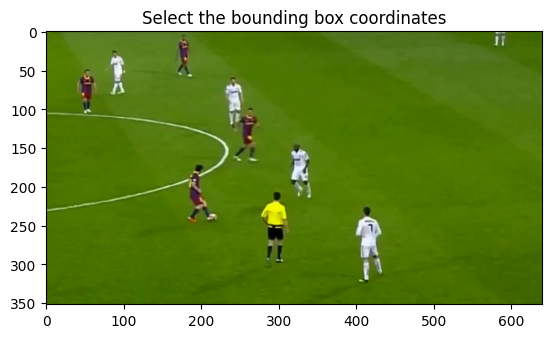

In [ ]:
video_path = '/content/drive/MyDrive/LaSOT/messi.mp4'
video_clip = VideoFileClip(video_path)
frames = [frame for frame in video_clip.iter_frames(fps=video_clip.fps, dtype='uint8')]
first_frame = frames[0]

# Create figure and axis
fig, ax = plt.subplots()

# Display the first frame
ax.imshow(first_frame)
plt.title("Select the bounding box coordinates")
plt.show()

array([[[101, 138,  37],
        [101, 138,  37],
        [101, 138,  37],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       [[ 85, 122,  21],
        [ 85, 122,  21],
        [ 85, 122,  21],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       [[ 78, 115,  12],
        [ 78, 115,  12],
        [ 78, 115,  12],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       ...,

       [[ 65, 105,   0],
        [ 65, 105,   0],
        [ 65, 105,   0],
        ...,
        [ 62, 101,   0],
        [ 60,  99,   0],
        [ 60,  99,   0]],

       [[ 66, 106,   0],
        [ 66, 106,   0],
        [ 66, 106,   0],
        ...,
        [ 62, 101,   0],
        [ 63, 102,   0],
        [ 63, 102,   0]],

       [[ 66, 106,   0],
        [ 66, 106,   0],
        [ 66, 106,   0],
        ...,
        [ 62, 101,   0],
        [ 63, 102,   0],
        [ 64, 103,   1]]], dtype=uint8)
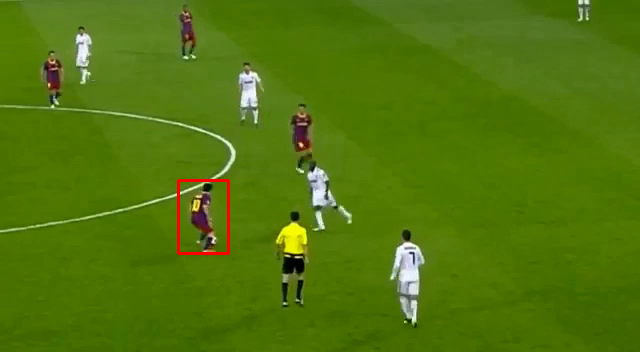

In [ ]:
frames[10]

In [ ]:
print("Enter the bounding box coordinates")
x = int(input("Enter the x-coordinate of the top-left corner: "))
y = int(input("Enter the y-coordinate of the top-left corner: "))
w = int(input("Enter the width of the bounding box: "))
h = int(input("Enter the height of the bounding box: "))
initial_region = (x, y, w, h)

Enter the bounding box coordinates
Enter the x-coordinate of the top-left corner: 173
Enter the y-coordinate of the top-left corner: 170
Enter the width of the bounding box: 50
Enter the height of the bounding box: 73


In [ ]:
def main(initial_region):
    # Track the object (you need to define HistogramTracker function)
    tracked_regions = HistogramTracker(frames, initial_region)

    # Annotate frames with the tracking results
    for i, frame in enumerate(frames):
        x, y, w, h = tracked_regions[i]
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)

# Run the main function
main(initial_region)

In [ ]:
output_path = '/content/drive/MyDrive/LaSOT/Histogram_demo_output_video.mp4'
create_video_from_frames(frames, output_path, fps=30)

array([[[101, 138,  37],
        [101, 138,  37],
        [101, 138,  37],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       [[ 85, 122,  21],
        [ 85, 122,  21],
        [ 85, 122,  21],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       [[ 78, 115,  12],
        [ 78, 115,  12],
        [ 78, 115,  12],
        ...,
        [ 64, 106,   0],
        [ 64, 106,   0],
        [ 64, 106,   0]],

       ...,

       [[ 65, 105,   0],
        [ 65, 105,   0],
        [ 65, 105,   0],
        ...,
        [ 62, 101,   0],
        [ 60,  99,   0],
        [ 60,  99,   0]],

       [[ 66, 106,   0],
        [ 66, 106,   0],
        [ 66, 106,   0],
        ...,
        [ 62, 101,   0],
        [ 63, 102,   0],
        [ 63, 102,   0]],

       [[ 66, 106,   0],
        [ 66, 106,   0],
        [ 66, 106,   0],
        ...,
        [ 62, 101,   0],
        [ 63, 102,   0],
        [ 64, 103,   1]]], dtype=uint8)
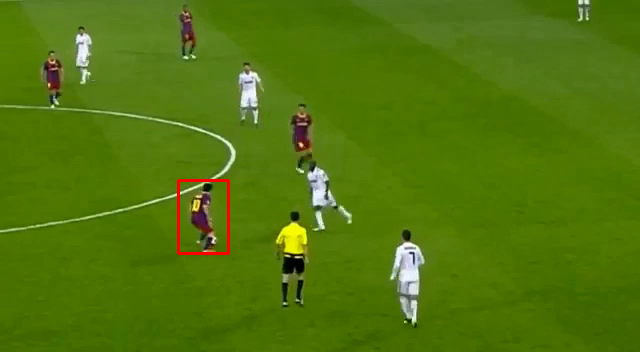

In [ ]:
frames[10]

In [ ]:
moviepy.editor.ipython_display(output_path)

## `6.2. YOLO + deepSORT`

### `6.2.1. Ví dụ về quy trình hoạt động của YOLO kết hợp deepSORT`

In [ ]:
# input frame
ex_frames = read_frames_from_folder('/content/drive/MyDrive/LaSOT/person-6/img')

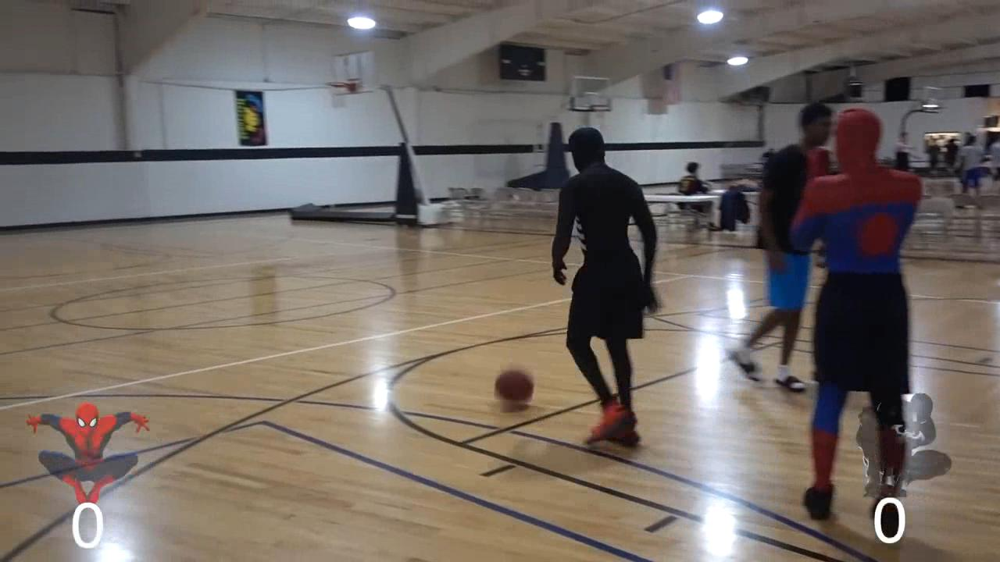

In [ ]:
cv2_imshow(ex_frames[0])

In [ ]:
results = model(ex_frames[0])
bboxes = []
for detect_object in results.pred[0]:
      bbox = detect_object[:4]
      x1, y1, x2, y2 = map(int, bbox)
      bbox_xywh = [x1, y1, x2-x1, y2-y1]
      bboxes.append(bbox_xywh)

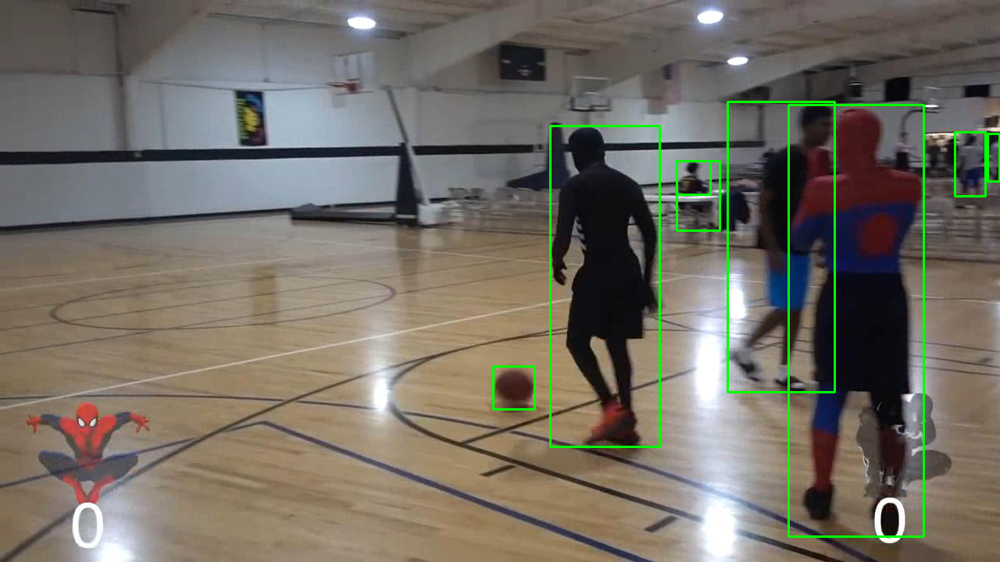

In [ ]:
# detection
frame = ex_frames[0].copy()
for bbox in bboxes:
    draw_bounding_box(frame, bbox, color=green)
cv2_imshow(frame)

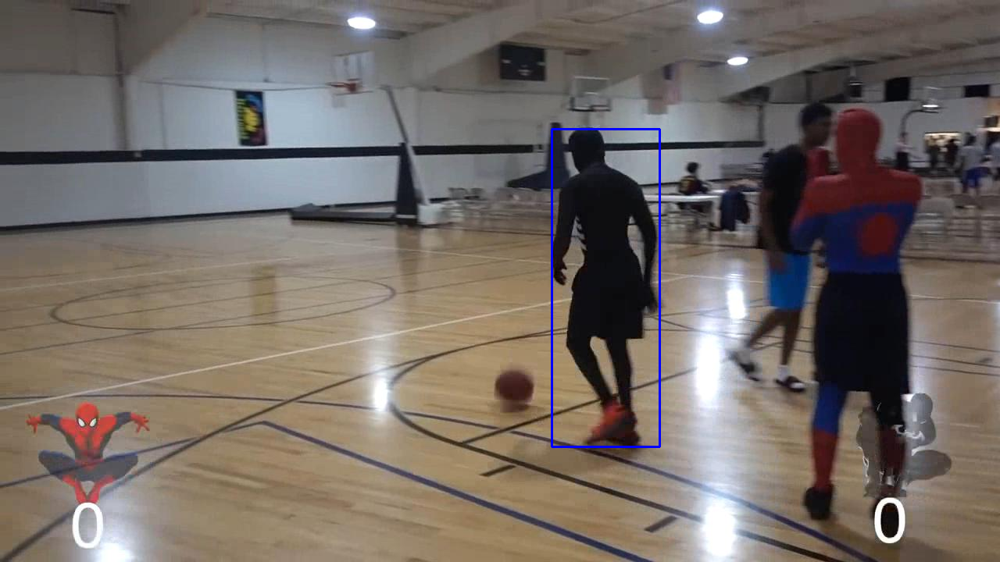

In [ ]:
# tracking
frame = ex_frames[0].copy()
draw_bounding_box(frame, [706,165,138,407], color=blue)
cv2_imshow(frame)

### `6.2.2. Demo video`

#### Video 1 - Cat

In [ ]:
# Demo with specific video

# read frames
video_path = '/content/drive/MyDrive/LaSOT/demo_video.mp4'
video_clip = VideoFileClip(video_path)
frames = [frame for frame in video_clip.iter_frames(fps=video_clip.fps, dtype='uint8')]
print(f'Reading frames finished! Total frames: {len(frames)}')

Reading frames finished! Total frames: 1703


Enter the bounding box coordinates
Enter the x-coordinate of the top-left corner: 500
Enter the y-coordinate of the top-left corner: 0
Enter the width of the bounding box: 510
Enter the height of the bounding box: 700


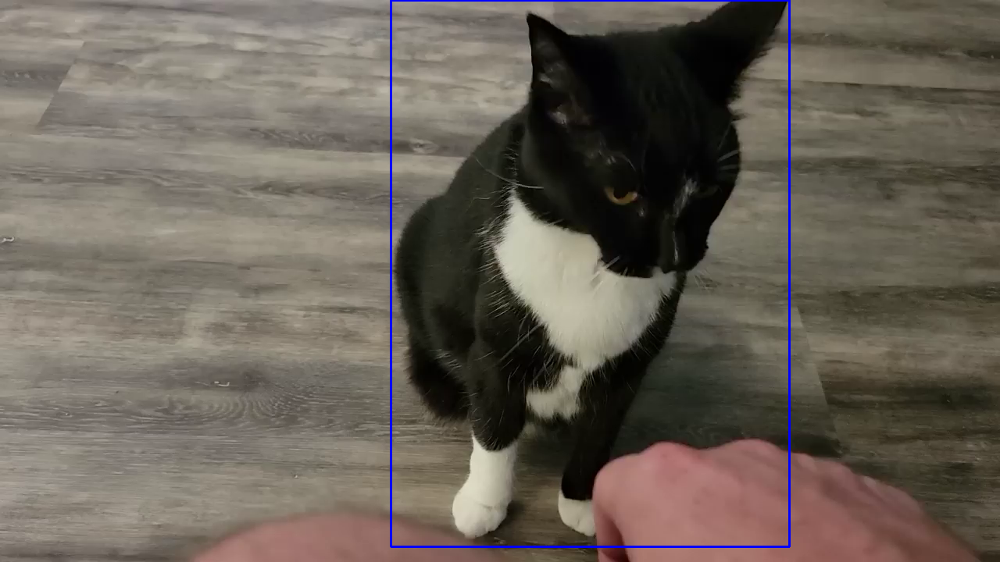

In [ ]:
print("Enter the bounding box coordinates")
x = int(input("Enter the x-coordinate of the top-left corner: "))
y = int(input("Enter the y-coordinate of the top-left corner: "))
w = int(input("Enter the width of the bounding box: "))
h = int(input("Enter the height of the bounding box: "))
bbox = (x, y, w, h)
frame = frames[0].copy()
draw_bounding_box(frame, bbox, color = blue)
cv2_imshow(frame)

In [ ]:
tracking_regions = YOLO_deepSORT_tracking(first_xywh = [x,y,w,h],
                                       tracking_class = class_name.index('cat'),
                                       frames = frames.copy(),
                                          max_age = 15)

Start tracking
--------------------------------------------------
frame: 1
frame: 201
frame: 401
frame: 601
frame: 801
frame: 1001
frame: 1201
frame: 1401
frame: 1601
Tracking finished


In [ ]:
for i in range(len(frames)):
    frame = frames[i]
    bbox = tracking_regions[i]
    draw_bounding_box(frame, bbox, color = blue)

create_video_from_frames(frames, '/content/drive/MyDrive/LaSOT/output_demo_video_YOLO.mp4',30)
moviepy.editor.ipython_display('/content/drive/MyDrive/LaSOT/output_demo_video_YOLO.mp4')

#### Video 2 - Person

In [ ]:
# read frames
video_path = '/content/drive/MyDrive/LaSOT/messi.mp4'
video_clip = VideoFileClip(video_path)
frames = [frame for frame in video_clip.iter_frames(fps=video_clip.fps, dtype='uint8')]
print(f'Reading frames finished! Total frames: {len(frames)}')

Reading frames finished! Total frames: 295


In [ ]:
tracking_regions = YOLO_deepSORT_tracking(first_xywh = [173, 170, 50, 73],      # result from histogram tracking
                                       tracking_class = class_name.index('person'),
                                       frames = frames.copy(),
                                       max_age = 20)
for i in range(len(frames)):
    frame = frames[i]
    bbox = tracking_regions[i]
    draw_bounding_box(frame, bbox, color = blue)

create_video_from_frames(frames, '/content/drive/MyDrive/LaSOT/output_demo_messi_YOLO.mp4',30)
moviepy.editor.ipython_display('/content/drive/MyDrive/LaSOT/output_demo_messi_YOLO.mp4')

Start tracking
--------------------------------------------------
frame: 1
frame: 201
Tracking finished
